## Diabetes Risk Forecast

##### Sources:
##### https://gis.cdc.gov/grasp/diabetes/DiabetesAtlas.html#
##### https://www.kaggle.com/vikasukani/diabetes-data-set

We build a machine learning model to accurately predict whether or not the patients in the dataset have diabetes or not. Since this will be a classification model, we will need to understand better about the parameters of our features / characteristics

- Pregnancies: Number of times pregnant
- Glucose: Plasma glucose concentration a 2 hours in an oral glucose tolerance test
- BloodPressure: Diastolic blood pressure (mm Hg)
- SkinThickness: Triceps skin fold thickness (mm)
- Insulin: 2-Hour serum insulin (mu U/ml)
- BMI: Body mass index (weight in kg/(height in m)^2)
- DiabetesPedigreeFunction: Diabetes pedigree function
- Age: Age (years)
- Outcome: Class variable (0 or 1) 684 of 2000 are 1, the others are 0

## General Information on Variables

### 1.Glucose Tolerance Test

It is a blood test that involves taking multiple blood samples over time, usually 2 hours.It used to diagnose diabetes. The results can be classified as normal, impaired, or abnormal.

- Normal Results for Diabetes -> Two-hour glucose level less than 140 mg/dL

- Impaired Results for Diabetes -> Two-hour glucose level 140 to 200 mg/dL

- Abnormal (Diagnostic) Results for Diabetes -> Two-hour glucose level greater than 200 mg/dL

### 2.BloodPressure

The diastolic reading, or the bottom number, is the pressure in the arteries when the heart rests between beats. This is the time when the heart fills with blood and gets oxygen. A normal diastolic blood pressure is lower than 80. A reading of 90 or higher means you have high blood pressure.

- Normal: Systolic below 120 and diastolic below 80
- Elevated: Systolic 120–129 and diastolic under 80
- Hypertension stage 1: Systolic 130–139 and diastolic 80–89
- Hypertension stage 2: Systolic 140-plus and diastolic 90 or more
- Hypertensive crisis: Systolic higher than 180 and diastolic above 120.

### 3.BMI

The standard weight status categories associated with BMI ranges for adults are shown in the following table.

- Below 18.5 -> Underweight
- 18.5 – 24.9 -> Normal or Healthy Weight
- 25.0 – 29.9 -> Overweight
- 30.0 and Above -> Obese

### 4.Triceps Skinfolds

For adults, the standard normal values for triceps skinfolds are:

18.0mm (women)

In [2]:
#importing the necessary libraries

import pandas as pd
import numpy as np

#visualization

import warnings
warnings.simplefilter(action="ignore")
import matplotlib.pyplot as plt
import seaborn as sns
%config InlineBackend.figure_formats = ['svg']  # or svg
%matplotlib inline

In [3]:
#reading the data set

df = pd.read_csv("/Users/hernantrujillo/Documents/Metis/NBM_Business_Student-main/Diabetes Risk Forecast Project/Diabetes Data/diabetes-dataset.csv")

### Exploratory Data Analysis

In [4]:
# To display the top 5 rows

df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,2,138,62,35,0,33.6,0.127,47,1
1,0,84,82,31,125,38.2,0.233,23,0
2,0,145,0,0,0,44.2,0.630,31,1
3,0,135,68,42,250,42.3,0.365,24,1
4,1,139,62,41,480,40.7,0.536,21,0


In [5]:
# To display the bottom 5 rows

df.tail()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
1995,2,75,64,24,55,29.7,0.370,33,0
1996,8,179,72,42,130,32.7,0.719,36,1
1997,6,85,78,0,0,31.2,0.382,42,0
1998,0,129,110,46,130,67.1,0.319,26,1
1999,2,81,72,15,76,30.1,0.547,25,0


In [6]:
# total number of rows and columns
# Dataset comprises of 1999 observations and 9 features.
# Out of which one is dependent variable and rest 8 are independent variables

df.shape

(2000, 9)

In [7]:
# Data has only float and integer values
# No variable column has null/missing values

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               2000 non-null   int64  
 1   Glucose                   2000 non-null   int64  
 2   BloodPressure             2000 non-null   int64  
 3   SkinThickness             2000 non-null   int64  
 4   Insulin                   2000 non-null   int64  
 5   BMI                       2000 non-null   float64
 6   DiabetesPedigreeFunction  2000 non-null   float64
 7   Age                       2000 non-null   int64  
 8   Outcome                   2000 non-null   int64  
dtypes: float64(2), int64(7)
memory usage: 140.8 KB


In [8]:
df.isna().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [9]:
# show how many column has 0 values and sum it

featureList = ['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']
print(df[featureList].isin({0}).sum())

Glucose           13
BloodPressure     90
SkinThickness    573
Insulin          956
BMI               28
dtype: int64


In [10]:
#There are most of the column has less then 50% of 0 values. To minimize this problem, we can replace zeros with mean values

# Set "0" to Mean values of perticular columns

for col in featureList:
  df[col] = df[col].replace({ 0 : df[col].mean() })

In [11]:
#Let's, check again how many 0 values available in data frame

df[featureList].isin({0}).sum()

Glucose          0
BloodPressure    0
SkinThickness    0
Insulin          0
BMI              0
dtype: int64

In [12]:
# To display the top 5 rows. No more "0" values in the features selected

df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,2,138.0,62.0000,35.000,80.254,33.6,0.127,47,1
1,0,84.0,82.0000,31.000,125.000,38.2,0.233,23,0
2,0,145.0,69.1455,20.935,80.254,44.2,0.630,31,1
3,0,135.0,68.0000,42.000,250.000,42.3,0.365,24,1
4,1,139.0,62.0000,41.000,480.000,40.7,0.536,21,0


In [13]:
# To display the bottom 5 rows. No more "0" values in the features selected

df.tail()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
1995,2,75.0,64.0,24.000,55.000,29.7,0.370,33,0
1996,8,179.0,72.0,42.000,130.000,32.7,0.719,36,1
1997,6,85.0,78.0,20.935,80.254,31.2,0.382,42,0
1998,0,129.0,110.0,46.000,130.000,67.1,0.319,26,1
1999,2,81.0,72.0,15.000,76.000,30.1,0.547,25,0


In [14]:
# Getting various summary statistics

df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,3.703500,121.970186,72.257047,26.932877,118.615412,32.643702,0.470930,33.090500,0.342000
std,3.306063,30.533180,11.968614,9.884003,88.366170,7.190337,0.323553,11.786423,0.474498
min,0.000000,44.000000,24.000000,7.000000,14.000000,18.200000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,64.000000,20.935000,80.254000,27.600000,0.244000,24.000000,0.000000
50%,3.000000,118.000000,72.000000,23.000000,80.254000,32.300000,0.376000,29.000000,0.000000
75%,6.000000,141.000000,80.000000,32.000000,130.000000,36.800000,0.624000,40.000000,1.000000
max,17.000000,199.000000,122.000000,110.000000,744.000000,80.600000,2.420000,81.000000,1.000000


In [15]:
# Target variable categorical

df.Outcome.unique()

array([1, 0])

In [16]:
df.Outcome.value_counts()

0    1316
1     684
Name: Outcome, dtype: int64

### Data Visualization

In [17]:
df_correlations = df.corr()

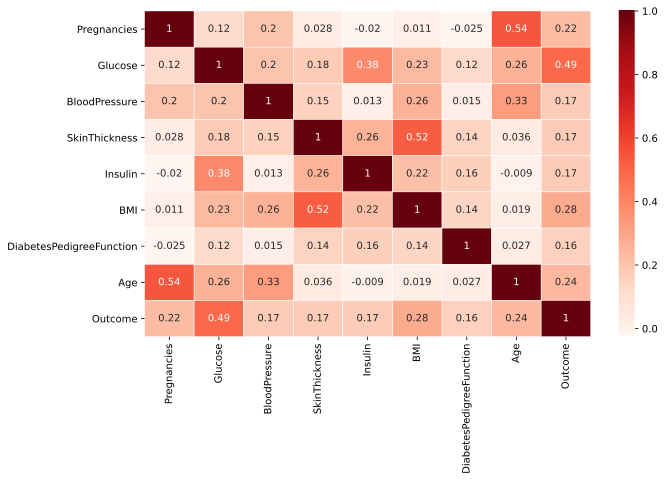

In [18]:
fig, ax = plt.subplots(figsize=(10,6))
sns.heatmap(df_correlations, cmap='Reds', annot=True, linewidths=.5, ax=ax);

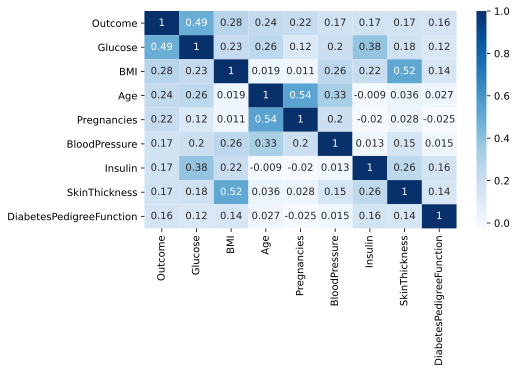

In [23]:
#Outcome correlation matrix in Desc order

k = 9 #number of variables for heatmap
cols = df.corr().nlargest(k, 'Outcome')['Outcome'].index
cm = df[cols].corr()
plt.figure(figsize=(7,4))
sns.heatmap(cm, annot=True, cmap = 'Blues');

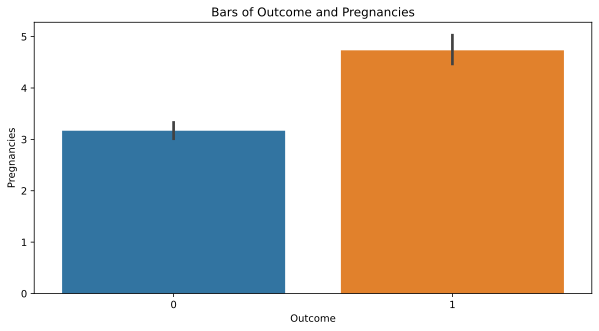

In [195]:
plt.figure(figsize=(10, 5))
sns.barplot('Outcome', 'Pregnancies', data=df) 

plt.title("Bars of Outcome and Pregnancies")
plt.xlabel("Outcome")
plt.ylabel("Pregnancies")
plt.show();

In [196]:
# pairplot with hue sex 

sns.pairplot(df) 
plt.show();

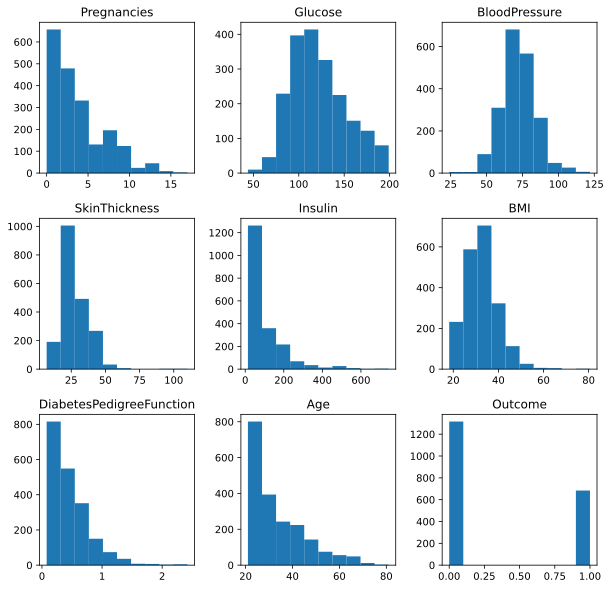

In [197]:
# see how the data is distributed

df.hist(figsize = (10,10), grid=False);

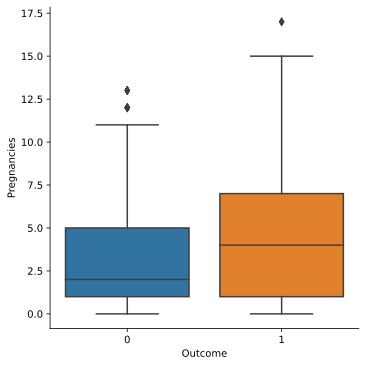

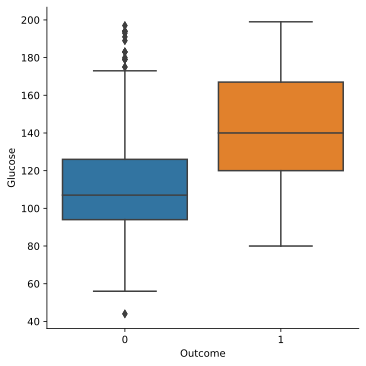

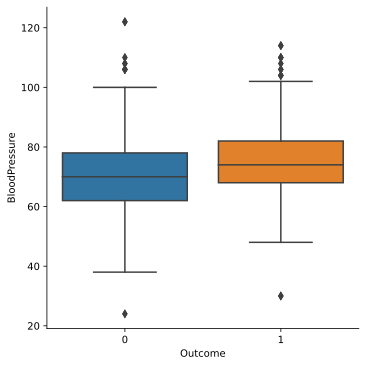

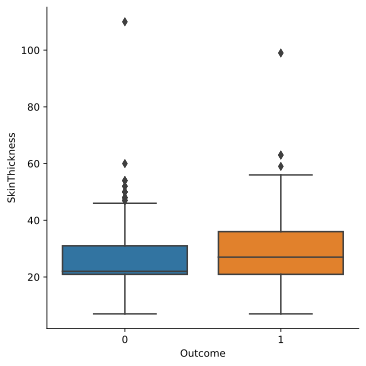

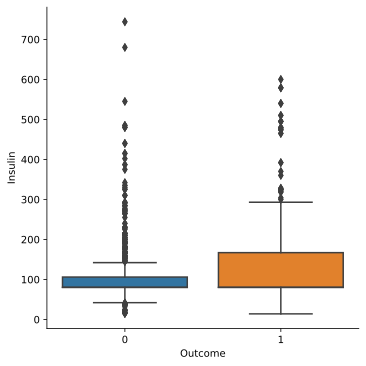

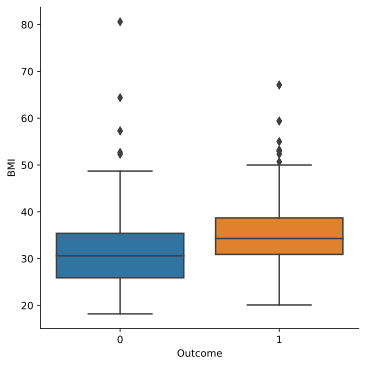

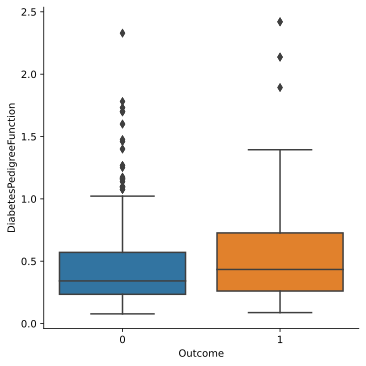

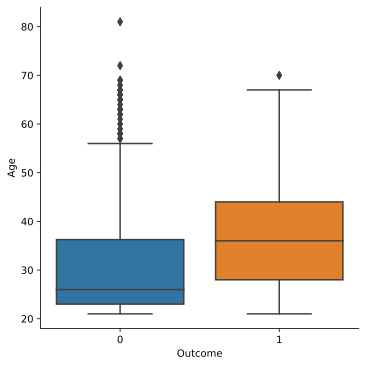

In [198]:
for col in df.columns:
    if col != "Outcome":
        sns.catplot("Outcome", col, data = df, kind="box")

### Feature Engineering

##### The only way logistic regression can actually classify stuff is if you apply a rule to the probability output. 


##### So, let's round ranges for each feature than can help us make classifications within each feature, and that will be our classification!

In [199]:
df['New_Glucose_Class'] = pd.cut(x=df['Glucose'], bins=[0,139,200],labels = ["Normal","Prediabetes"])

In [200]:
df['New_BMI_Range'] = pd.cut(x=df['BMI'], bins=[0,18.5,24.9,29.9,100],labels = ["Underweight","Healty","Overweight","Obese"])

In [201]:
df['New_BloodPressure'] = pd.cut(x=df['BloodPressure'], bins=[0,79,89,123],labels = ["Normal","HS1","HS2"])

In [202]:
df['New_SkinThickness'] = df['SkinThickness'].apply(lambda x: 1 if x <= 18.0 else 0)

In [203]:
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome,New_Glucose_Class,New_BMI_Range,New_BloodPressure,New_SkinThickness
0,2,138.0,62.0000,35.000,80.254,33.6,0.127,47,1,Normal,Obese,Normal,0
1,0,84.0,82.0000,31.000,125.000,38.2,0.233,23,0,Normal,Obese,HS1,0
2,0,145.0,69.1455,20.935,80.254,44.2,0.630,31,1,Prediabetes,Obese,Normal,0
3,0,135.0,68.0000,42.000,250.000,42.3,0.365,24,1,Normal,Obese,Normal,0
4,1,139.0,62.0000,41.000,480.000,40.7,0.536,21,0,Normal,Obese,Normal,0


In [204]:
df.shape

(2000, 13)

In [205]:
df.isna().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
New_Glucose_Class           0
New_BMI_Range               0
New_BloodPressure           0
New_SkinThickness           0
dtype: int64

In [206]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Pregnancies               2000 non-null   int64   
 1   Glucose                   2000 non-null   float64 
 2   BloodPressure             2000 non-null   float64 
 3   SkinThickness             2000 non-null   float64 
 4   Insulin                   2000 non-null   float64 
 5   BMI                       2000 non-null   float64 
 6   DiabetesPedigreeFunction  2000 non-null   float64 
 7   Age                       2000 non-null   int64   
 8   Outcome                   2000 non-null   int64   
 9   New_Glucose_Class         2000 non-null   category
 10  New_BMI_Range             2000 non-null   category
 11  New_BloodPressure         2000 non-null   category
 12  New_SkinThickness         2000 non-null   int64   
dtypes: category(3), float64(6), int64(4)
memory usag

#### Dummies for categorical features

In [207]:
def dummies(dataframe, categorical_columns, nan_as_category=False):
    original_columns = list(dataframe.columns)
    dataframe = pd.get_dummies(dataframe, columns=categorical_columns,
                               dummy_na=nan_as_category, drop_first=True)
    new_columns = [col for col in dataframe.columns if col not in original_columns]
    return dataframe, new_columns
categorical_columns = [col for col in df.columns
                           if len(df[col].unique()) <= 10
                      and col != "Outcome"]
categorical_columns

['New_Glucose_Class',
 'New_BMI_Range',
 'New_BloodPressure',
 'New_SkinThickness']

In [208]:
df, new_cols_dummy = dummies(df,categorical_columns)
new_cols_dummy

['New_Glucose_Class_Prediabetes',
 'New_BMI_Range_Healty',
 'New_BMI_Range_Overweight',
 'New_BMI_Range_Obese',
 'New_BloodPressure_HS1',
 'New_BloodPressure_HS2',
 'New_SkinThickness_1']

In [213]:
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome,New_Glucose_Class_Prediabetes,New_BMI_Range_Healty,New_BMI_Range_Overweight,New_BMI_Range_Obese,New_BloodPressure_HS1,New_BloodPressure_HS2,New_SkinThickness_1
0,2,138.0,62.0000,35.000,80.254,33.6,0.127,47,1,0,0,0,1,0,0,0
1,0,84.0,82.0000,31.000,125.000,38.2,0.233,23,0,0,0,0,1,1,0,0
2,0,145.0,69.1455,20.935,80.254,44.2,0.630,31,1,1,0,0,1,0,0,0
3,0,135.0,68.0000,42.000,250.000,42.3,0.365,24,1,0,0,0,1,0,0,0
4,1,139.0,62.0000,41.000,480.000,40.7,0.536,21,0,0,0,0,1,0,0,0


In [214]:
# saving df_final to csv

df_final = df.to_csv("/Users/hernantrujillo/Documents/Metis/NBM_Business_Student-main/Diabetes Risk Forecast Project/df_final.csv")


In [217]:
#reading df_final set

df = pd.read_csv("/Users/hernantrujillo/Documents/Metis/NBM_Business_Student-main/Diabetes Risk Forecast Project/df_final.csv")

In [219]:
df.head()

,Unnamed: 0,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome,New_Glucose_Class_Prediabetes,New_BMI_Range_Healty,New_BMI_Range_Overweight,New_BMI_Range_Obese,New_BloodPressure_HS1,New_BloodPressure_HS2,New_SkinThickness_1
0,0,2,138.0,62.0000,35.000,80.254,33.6,0.127,47,1,0,0,0,1,0,0,0
1,1,0,84.0,82.0000,31.000,125.000,38.2,0.233,23,0,0,0,0,1,1,0,0
2,2,0,145.0,69.1455,20.935,80.254,44.2,0.630,31,1,1,0,0,1,0,0,0
3,3,0,135.0,68.0000,42.000,250.000,42.3,0.365,24,1,0,0,0,1,0,0,0
4,4,1,139.0,62.0000,41.000,480.000,40.7,0.536,21,0,0,0,0,1,0,0,0


### Modeling

In [235]:
# importing libraries for modeling

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, \
    classification_report
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score

In [236]:
X = df.drop("Outcome",axis=1)
y = df["Outcome"]

In [237]:
models = [('LR', LogisticRegression()),
          ('KNN', KNeighborsClassifier()),
          ('CART', DecisionTreeClassifier())]

results = []
names = []

for name, model in models:
    kfold = KFold(n_splits=5, random_state=1000000)
    cv_results = cross_val_score(model, X, y, cv=kfold, scoring="accuracy")
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

LR: 0.743500 (0.056294)
KNN: 0.640500 (0.047101)
CART: 0.957500 (0.043675)


##### Conclusion:
- Classification models used for diabetes data set; Logistic Regression, KNeighborsClassifier, DecisionTreeClassifier.
- The best cross validation score belongs to DecisionTreeClassifier with 95%.
- We have a low standard deviation (0.02) which indicates that the values tend to be close to the mean of the set.